In [39]:
import matplotlib.pyplot as plt

In [40]:
from scipy.signal import spectrogram

In [41]:
import numpy as np

In [42]:
import pickle, glob

In [43]:
import sys,os

In [45]:
Path_FieldTrip = "/buffer_bci-master/dataAcq/buffer/python"
sys.path.append(os.getcwd() + Path_FieldTrip)

import FieldTrip

In [46]:
Path_Preproc = "/buffer_bci-master/python/signalproc"
sys.path.append(os.getcwd() + Path_Preproc)


import preproc

 f = open('continuous_data')

In [118]:
ch = '''  1) Matched : FP1	 ->	 FP1
  2) Matched : FPz	 ->	 FPz
  3) Matched : FP2	 ->	 FP2
  4) Matched : AF7	 ->	 AF7
  5) Matched : AFz	 ->	 AFz
  6) Matched : AF8	 ->	 AF8
  7) Matched : F3	 ->	 F3
  8) Matched : Fz	 ->	 Fz
  9) Matched : F4	 ->	 F4
 10) Matched : FC5	 ->	 FC5
 11) Matched : FC1	 ->	 FC1
 12) Matched : FC2	 ->	 FC2
 13) Matched : FC6	 ->	 FC6
 14) Matched : T9	 ->	 T9
 15) Matched : C3	 ->	 C3
 16) Matched : Cz	 ->	 Cz
 17) Matched : C4	 ->	 C4
 18) Matched : T10	 ->	 T10
 19) Matched : CP1	 ->	 CP1
 20) Matched : CP2	 ->	 CP2
 21) Matched : P3	 ->	 P3
 22) Matched : Pz	 ->	 Pz
 23) Matched : P4	 ->	 P4
 24) Matched : TP9	 ->	 TP9
 25) Matched : P7	 ->	 P7
 26) Matched : POz	 ->	 POz
 27) Matched : O1	 ->	 O1
 28) Matched : Oz	 ->	 Oz
 29) Matched : O2	 ->	 O2
 30) Matched : TP10	 ->	 TP10'''

In [119]:
ch_32 = {}
for i in ch.split('\n'):
    #print(i.split(')')[0].replace(' ',''))
    #print(i.split('->')[-1].replace('	 ',''))
    ch_32[str(i.split(')')[0].replace(' ',''))] = str(i.split('->')[-1].replace('	 ',''))
ch_32['1']

'FP1'

In [120]:
ch_32_r = {}
for i in ch.split('\n'):
    #print(i.split(')')[0].replace(' ',''))
    #print(i.split('->')[-1].replace('	 ',''))
    ch_32_r[str(i.split('->')[-1].replace('	 ',''))] = int(i.split(')')[0].replace(' ',''))-1

Processin the data form the file 4 up to 15

In [83]:
 # 0 - left, 1 -right, 2 - both

values_hands = {'0':'left', '1':'right', '2':'both', '3':'both' }

In [111]:
init  = 16
final = 21

exp = [0]*init
for i in range(init, final +1):
    file = 'data/training_data_imagined_movement-'
    print(i, file+str(i)+'.pk')
    f = open(file+str(i)+'.pk', 'rb')
    exp.append(pickle.load(f))



16 data/training_data_imagined_movement-16.pk
17 data/training_data_imagined_movement-17.pk
18 data/training_data_imagined_movement-18.pk
19 data/training_data_imagined_movement-19.pk
20 data/training_data_imagined_movement-20.pk
21 data/training_data_imagined_movement-21.pk


In [114]:

    
    
#-----------------------------------
    
    
left_hand_mov   =  []
right_hand_mov  =  []
both_hands_mov  =  []
no_hand_mov     =  []


verbose = True


#Counters

right = 0
left = 0
both = 0


for n_exp in range(init,final+1):
    print(' ***********   Experiment  '+str(n_exp)+'   *********** ')
    
    print(np.array(exp[n_exp]['data']).shape)
    
    data           =   np.array(exp[n_exp]['data'])   #data support variable
    data           =   np.transpose(data)
    data           =   preproc.detrend(data);
    data           =   preproc.spatialfilter(data, type = 'car')
    data, freqs    =   preproc.powerspectrum(data,dim = 1,fSample=exp[i]['hdr'].fSample);
    data,freqIdx   =   preproc.selectbands(data,dim=1,band=[6,13,20,27],bins=freqs);
    goodtr, badtr  =   preproc.outlierdetection(data, dim = 2)
    data = data[:,:, goodtr]
    
    #if verbose: print(freqs)
    
    if verbose: print(data.shape)
        
    
    n_events = data.shape[2]
    for event in range(n_events):
        
        if verbose: print(exp[n_exp]['events'][event].value[0])
        
        if exp[n_exp]['events'][event].value[0] == 0:
            if verbose: print('left')
            left = left + 1
            left_hand_mov.append(data[:,:,event])
        
        
        if exp[n_exp]['events'][event].value[0] == 1:
            if verbose: print('right')
            right = right +1
            right_hand_mov.append(data[:,:,event])
        
            
        if exp[n_exp]['events'][event].value[0] == 2:
            if verbose: print('both')
            both = both + 1
            both_hands_mov.append(data[:,:,event])
            
        if exp[n_exp]['events'][event].value[0] == 3:
            if verbose: print('both')
            both = both + 1
            no_hand_mov.append(data[:,:,event])
           

left_hand_mov    =   np.array(left_hand_mov)
right_hand_mov   =   np.array(right_hand_mov)
both_hands_mov   =   np.array(both_hands_mov)
no_hand_mov      =   np.array(no_hand_mov)

 ***********   Experiment  16   *********** 
(24, 750, 37)
(37, 62, 22)
3
both
2
both
2
both
1
right
3
both
3
both
2
both
1
right
2
both
1
right
0
left
1
right
0
left
2
both
1
right
0
left
2
both
3
both
3
both
1
right
0
left
3
both
 ***********   Experiment  17   *********** 
(24, 750, 37)
(37, 62, 24)
1
right
0
left
0
left
3
both
2
both
0
left
2
both
1
right
2
both
0
left
3
both
2
both
1
right
3
both
2
both
3
both
1
right
1
right
0
left
2
both
0
left
3
both
1
right
3
both
 ***********   Experiment  18   *********** 
(24, 750, 37)
(37, 62, 24)
1
right
3
both
3
both
0
left
2
both
1
right
1
right
0
left
2
both
2
both
3
both
0
left
2
both
1
right
0
left
1
right
2
both
0
left
3
both
2
both
3
both
3
both
1
right
0
left
 ***********   Experiment  19   *********** 
(24, 750, 37)
(37, 62, 23)
2
both
0
left
0
left
2
both
0
left
2
both
1
right
3
both
2
both
0
left
3
both
1
right
1
right
3
both
0
left
3
both
3
both
0
left
1
right
1
right
1
right
2
both
2
both
 ***********   Experiment  20   *****

In [115]:
print(left_hand_mov.shape)
print(right_hand_mov.shape)
print(both_hands_mov.shape)
print(no_hand_mov.shape)

(34, 37, 62)
(35, 37, 62)
(35, 37, 62)
(34, 37, 62)


In [116]:
power_spectrum = {'left':left_hand_mov, 'right': right_hand_mov, 'both': both_hands_mov, 'no':no_hand_mov}

f = open('power_spectrum.pk', 'wb')

pickle.dump(power_spectrum, f)

In [117]:
#goodtr, badtr = preproc.outlierdetection(data, dim = 2)

In [96]:
data.shape

(37, 62, 22)

In [97]:
ch_32_r['C3']

14

In [98]:
left_hand_mov.shape

(79, 37, 62)

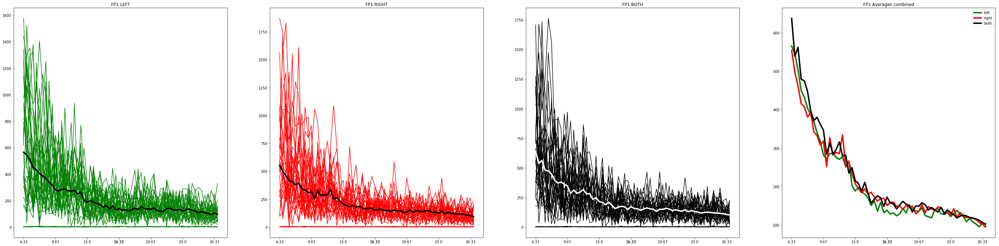

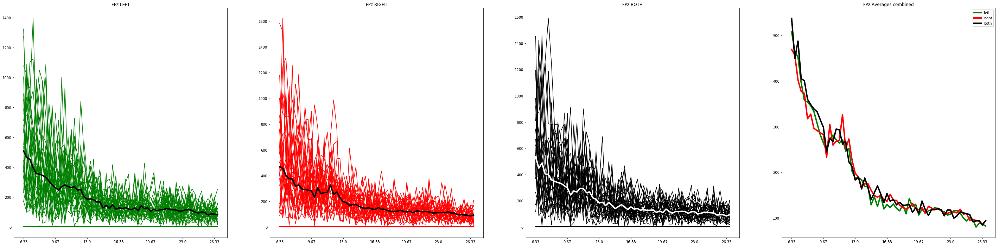

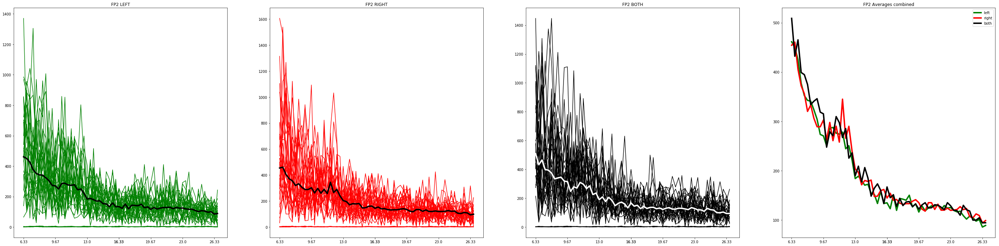

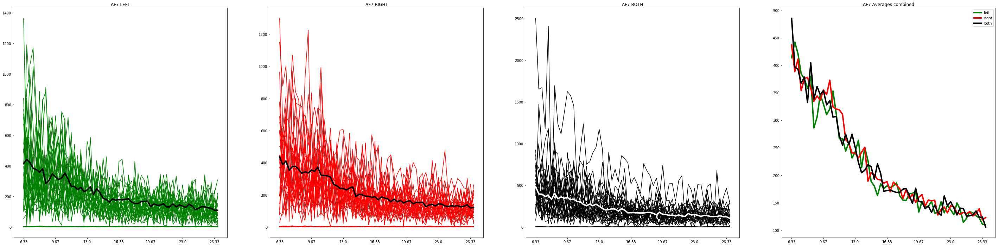

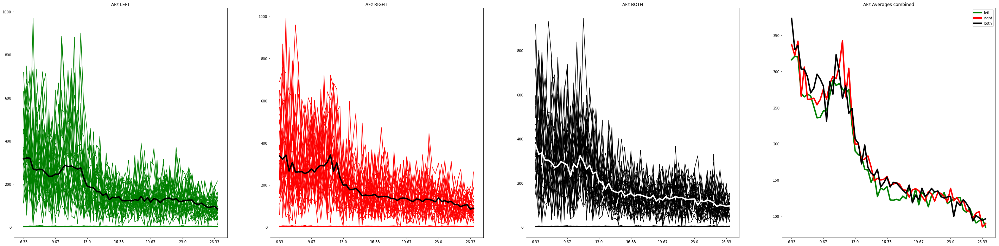

...

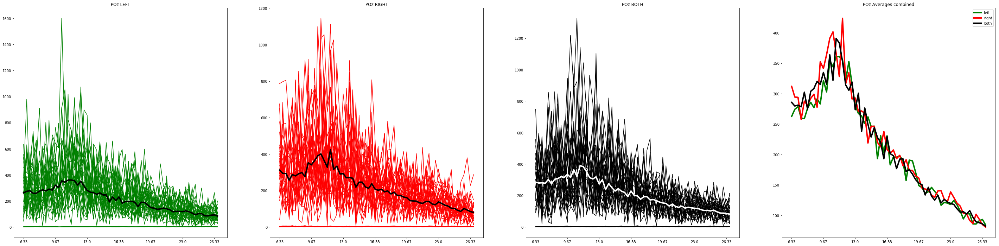

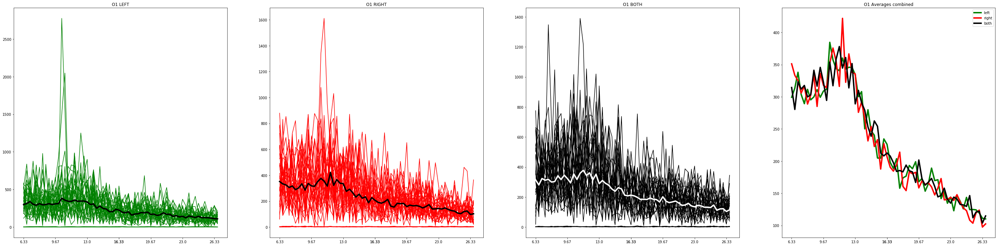

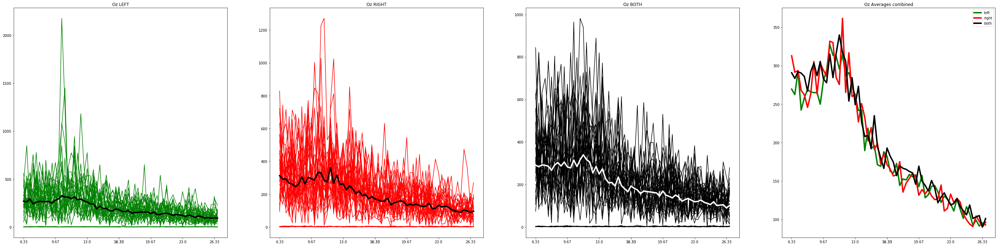

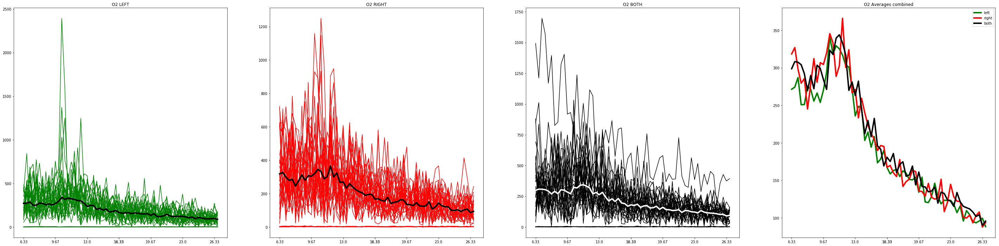

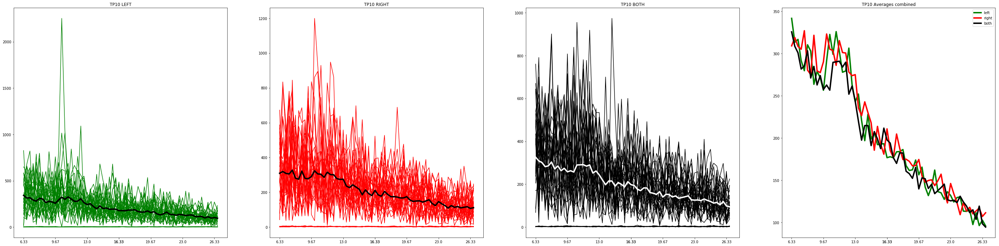

In [99]:
channels = ch_32_r.keys()

labels =[0,10,20,30,30,40,50,60]
freq_labels = np.around(freqs[freqIdx], decimals = 2)

verbose = True
log = False

for channel in channels:

    fig, (ax0,ax1,ax2, ax3) = plt.subplots(1,4, figsize = (50,12))

    for i in range(35):
        #data[int(ch_32_r['C3']),:,i]
        #print('---')
        #print(exp[-1]['events'][i].value[0])

        if i<left_hand_mov.shape[0]:
            ax0.set_title(channel + ' ' + 'LEFT')
            if log: ax0.set_yscale('log')
            ax0.plot(left_hand_mov[i, int(ch_32_r[channel]),:], color = 'g')
            ax0.set_xticks(labels)
            ax0.set_xticklabels(freq_labels[labels])
        
        if i<right_hand_mov.shape[0]:
            ax1.set_title(channel + ' ' + 'RIGHT')
            if log: ax1.set_yscale('log')
            ax1.plot(right_hand_mov[i, int(ch_32_r[channel]),:], color = 'r')
            ax1.set_xticks(labels)
            ax1.set_xticklabels(freq_labels[labels])

        if i<both_hands_mov.shape[0]:
            ax2.set_title(channel + ' ' + 'BOTH')
            if log: ax2.set_yscale('log')
            ax2.plot(both_hands_mov[i, int(ch_32_r[channel]),:], color = 'k')
            ax2.set_xticks(labels)
            ax2.set_xticklabels(freq_labels[labels])
        
    ax0.plot(np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'k', linewidth = 4)
    ax1.plot(np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'k', linewidth = 4)
    ax2.plot(np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0), color = 'w', linewidth = 4)

    ax3.set_title(channel + ' Averages combined')
    ax3.plot(np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'g', linewidth = 4, label = 'left')
    ax3.plot(np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'r', linewidth = 4, label = 'right')
    ax3.plot(np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0), color =  'k', linewidth = 4, label = 'both')
    ax3.set_xticks(labels)
    ax3.set_xticklabels(freq_labels[labels])
    ax3.legend()
    
    
    plt.savefig('channels_img/'+ str(ch_32_r[channel]) + '-' + channel+'.png')
    
    plt.show()

IndexError: index 0 is out of bounds for axis 0 with size 0

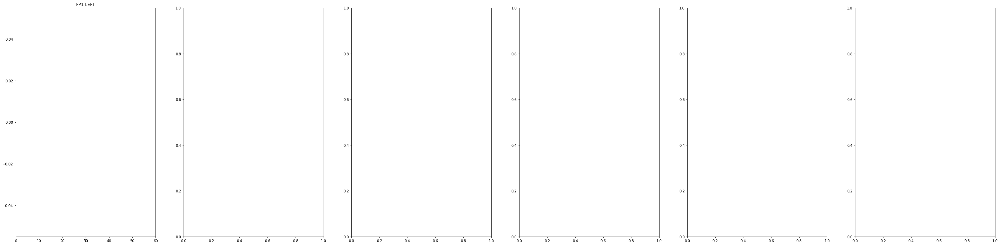

In [23]:
channels = ch_32_r.keys()

labels =[0,10,20,30,30,40,50,60]
freq_labels = np.around(freqs[freqIdx], decimals = 2)

verbose = True
log = False

for channel in channels:

    fig, (ax0,ax1,ax2, ax3, ax4, ax5) = plt.subplots(1,6, figsize = (50,12))

    for i in range(35):
        #data[int(ch_32_r['C3']),:,i]
        #print('---')
        #print(exp[-1]['events'][i].value[0])

        if i<left_hand_mov.shape[0]:
            ax0.set_title(channel + ' ' + 'LEFT')
            if log: ax0.set_yscale('log')
            ax0.plot(left_hand_mov[i, int(ch_32_r[channel]),:], color = 'g')
            ax0.set_xticks(labels)
            ax0.set_xticklabels(freq_labels[labels])
        
        if i<right_hand_mov.shape[0]:
            ax1.set_title(channel + ' ' + 'RIGHT')
            if log: ax1.set_yscale('log')
            ax1.plot(right_hand_mov[i, int(ch_32_r[channel]),:], color = 'r')
            ax1.set_xticks(labels)
            ax1.set_xticklabels(freq_labels[labels])

        if i<both_hands_mov.shape[0]:
            ax2.set_title(channel + ' ' + 'BOTH')
            if log: ax2.set_yscale('log')
            ax2.plot(both_hands_mov[i, int(ch_32_r[channel]),:], color = 'k')
            ax2.set_xticks(labels)
            ax2.set_xticklabels(freq_labels[labels])
        
        if i<no_hand_mov.shape[0]:
            ax3.set_title(channel + ' ' + 'NONE')
            ax3.plot(no_hand_mov[i, int(ch_32_r[channel]),:], color = 'indigo')
            ax3.set_xticks(labels)
            ax3.set_xticklabels(freq_labels[labels])
        
    ax0.plot(np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'k', linewidth = 4)
    ax1.plot(np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'k', linewidth = 4)
    ax2.plot(np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0), color = 'w', linewidth = 4)
    ax3.plot(np.mean(no_hand_mov[:, ch_32_r[channel],:], axis=0), color =  'w', linewidth = 4, label = 'none')

    ax4.set_title(channel + ' Averages combined')
    ax4.plot(np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'g', linewidth = 4, label = 'left')
    ax4.plot(np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'r', linewidth = 4, label = 'right')
    #ax4.plot(np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0), color =  'k', linewidth = 4, label = 'both')
    #ax4.plot(np.mean(no_hand_mov[:, ch_32_r[channel],:], axis=0), color =  'indigo', linewidth = 4, label = 'none')
    ax4.legend()
    
    ax5.set_title(channel + ' Averages combined')
    ax5.plot(np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'g', linewidth = 4, label = 'left')
    ax5.plot(np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0), color = 'r', linewidth = 4, label = 'right')
    ax5.plot(np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0), color =  'k', linewidth = 4, label = 'both')
    ax5.plot(np.mean(no_hand_mov[:, ch_32_r[channel],:], axis=0), color =  'indigo', linewidth = 4, label = 'none')
    ax5.legend()
    
    #plt.savefig('channels_img/'+channel+'.png')
    
    plt.show()

In [ ]:
def inv_f(x, a):
    return a/x

In [ ]:
from scipy.optimize import curve_fit

for channel in ch_32_r.keys():
    right_avg = np.mean(left_hand_mov[:, ch_32_r[channel],:], axis=0)
    left_avg  = np.mean(right_hand_mov[:, ch_32_r[channel],:], axis=0)
    both_avg  = np.mean(both_hands_mov[:, ch_32_r[channel],:], axis=0)
    
    popt_l, pcov_f = curve_fit(inv_f, np.around(freqs[freqIdx], decimals = 2), left_avg)

---- 

preproc examples (check out later the select band thing) 

data_14 = np.array(exp[14]['data'])

data_14 = np.transpose(data_14)

data_14 = preproc.detrend(data_14)

for i in range(37):
    plt.plot(data_14[i,:,1])
    plt.show()

data_14 = preproc.spatialfilter(data_14 ,type='spatialfilter')

for i in range(37):
    plt.plot(data_14[i,:,1])
    plt.show()

data_14 ,freqs = preproc.powerspectrum(data_14,dim=1,fSample=exp[14]['hdr'].fSample)

for i in range(37):
    plt.plot(data_14[i,:,1][:50])
    print('')
    plt.show()

-------------------------

In [24]:
left_hand_mov[:, ch_32_r['C3'],:].shape

(90, 0)

In [25]:
np.mean(left_hand_mov[:, ch_32_r['C3'],:], axis=0)

array([], dtype=float64)

In [26]:
np.mean?

Signature: np.mean(a, axis=None, dtype=None, out=None, keepdims=<no value>)
Docstring:
Compute the arithmetic mean along the specified axis.

Returns the average of the array elements.  The average is taken over
the flattened array by default, otherwise over the specified axis.
`float64` intermediate and return values are used for integer inputs.

Parameters
----------
a : array_like
    Array containing numbers whose mean is desired. If `a` is not an
    array, a conversion is attempted.
axis : None or int or tuple of ints, optional
    Axis or axes along which the means are computed. The default is to
    compute the mean of the flattened array.

    .. versionadded:: 1.7.0

    If this is a tuple of ints, a mean is performed over multiple axes,
    instead of a single axis or all the axes as before.
dtype : data-type, optional
    Type to use in computing the mean.  For integer inputs, the default
    is `float64`; for floating point inputs, it is the same as the
    input dtype.
ou

In [43]:
%%html
<img src='mobita_32.png', width = 600, height = 600> 

Channels numbers

In [44]:
ch_32_r['C3']

'15'

In [45]:
ch_32_r['Cz']

'16'

In [46]:
ch_32_r['C4']

'17'

In [79]:
data = {'left_hand_mov':left_hand_mov, 'right_hand_mov': right_hand_mov, 'both_hands_mov' : both_hands_mov}
f = open('data_power.pk', 'wb')
pickle.dump(data, f)